# Generative Adversarial Networks
In this assignment, you’ll get hands-on experience coding and training GANs. This assignment is divided into two parts: in the first part, we will implement a specific type of GAN designed to process images, called a Conditional GAN (CGAN). We’ll train the CGAN to generate images from samples of random noise. In the second part, we will interpolate some images for that you will be given a model.

**Note:** Please attempt this assignment on Google Colab, since that will speed up the training process. 

In [ ]:
import os
import keras
import random
import numpy as np
from glob import glob
import tensorflow as tf
import keras.backend as K
from keras.layers import *
from scipy.stats import norm
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import tensorflow_datasets as tfds
from tensorflow.keras.utils import to_categorical
from keras.models import Sequential, Model
from keras.initializers import RandomNormal
from mpl_toolkits.axes_grid1 import ImageGrid
from keras.utils.generic_utils import Progbar
from tensorflow.keras.optimizers import Adam, SGD, RMSprop
from keras.preprocessing.image import ImageDataGenerator
from google.colab import drive
drive.mount('/drive')

Mounted at /drive


**NOTE** 
1. You need to change your notebook name to CS437_DL_HW5_[YOUR ID] 
2. Just upload the Notebook, you don't need to zip it 

In [ ]:
# Use these variables
ROLLNUMBER = 21100089
BATCH_SIZE = 300   # take a small batch size so that your runtime won't crash
IMAGE_SHAPE = (96,96,3)
CHANNELS = 3
NOISE_DIM = 100
EPOCHS = 500 

## Task 1| Conditional GANS

For the first part of this assignment, we will implement a Conditioanl GAN (CGAN). Conditional Generative Adversarial Network is a type of GAN that involves the conditional generation of images by a generator model. You can find the paper to under the concept.

https://arxiv.org/pdf/1411.1784.pdf

*   STL-10 is the tensorflow Prefetch dataset, you need to convert it to numpy arrays | https://cs.stanford.edu/~acoates/stl10/
*   Combine the train and test dataset so the total size of the training set would be 13000. 



In [ ]:
## Helper Functions
def sample_noise():
    return np.reshape(np.random.randn(NOISE_DIM * BATCH_SIZE),(BATCH_SIZE,NOISE_DIM))

def load_data():
    dataloader = tfds.load("Stl10", as_supervised=True)
    train, test = dataloader["train"], dataloader["test"]
    return (train, test)

def create_image_grid(array, ncols=None):
    num_images, cell_h, cell_w, channels = array.shape
    if not ncols:
        ncols = int(np.sqrt(num_images))
    nrows = int(np.math.floor(num_images / float(ncols)))
    result = np.zeros((cell_h*nrows, cell_w*ncols, channels), dtype=array.dtype)
    for i in range(0, nrows):
        for j in range(0, ncols):
            result[i*cell_h:(i+1)*cell_h, j*cell_w:(j+1)*cell_w, :] = array[i*ncols+j]

    if channels == 1:
        result = result.squeeze()
    return result

def display_image_grid(images, num_rows, num_cols, title_text):

    fig = plt.figure(figsize=(num_cols*3., num_rows*3.), )
    grid = ImageGrid(fig, 111, nrows_ncols=(num_rows, num_cols), axes_pad=0.15)

    for ax, im in zip(grid, images):
        im = im/np.amax(im)
        im = np.clip(im, 0, 1)
        ax.imshow(im)
        ax.axis("off")
    
    plt.suptitle(title_text, fontsize=20)
    plt.show()

### Step 1 | Load the dataset




In [ ]:
# WRITE YOUR CODE HERE
X_train_and_labels , X_test_and_labels = load_data()

X_train_and_labels = list(tfds.as_numpy(X_train_and_labels))

X_test_and_labels = list(tfds.as_numpy(X_test_and_labels))

X_train = np.array([X_train_and_labels[i][0].astype('float32') for i in range(5000)])

y_train_labels = np.array([X_train_and_labels[i][1] for i in range(5000)])

X_test = np.array([X_test_and_labels[i][0].astype('float32') for i in range(8000)])

y_test_labels = np.array([X_test_and_labels[i][1] for i in range(8000)])

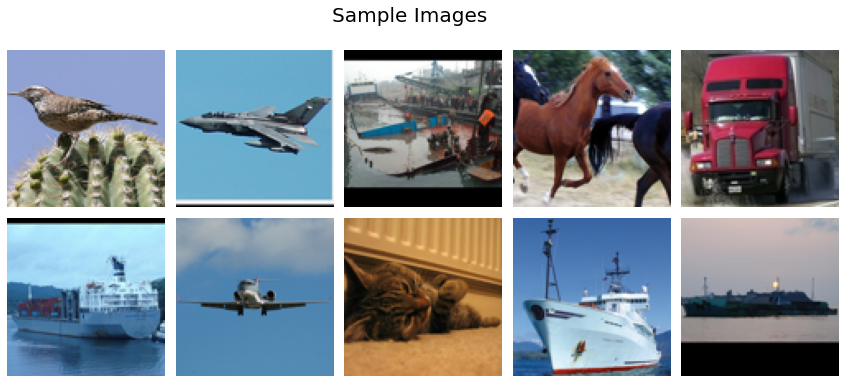

In [ ]:
sample_images = X_train[100:110]
display_image_grid(sample_images, 2, 5, "Sample Images")

**Note**| Dataset is in PrefetchDataset shape, you need to extract the images and labels out of it. After that you may want to apply preprocessing i.e., changing the d-type and labels to one-hot labels

https://www.tensorflow.org/datasets/performances

In [ ]:
# WRITE YOUR CODE HERE
y_train = tf.one_hot(y_train_labels,10).numpy()

y_test = tf.one_hot(y_test_labels,10).numpy()

#### Combine the X_train and X_test and their labels as you are not required the test set to evaluate Gan.

In [ ]:
# WRITE YOUR CODE HERE
X_train = np.concatenate((X_train,X_test),axis = 0)

y_train = np.concatenate((y_train,y_test),axis = 0)

After that your X_train.shape yeilds (13000, 96, 96, 3)

In [ ]:
X_train.shape

(13000, 96, 96, 3)

### Step 2 | Implementing the Discriminator Network
The discriminator network distinguishes between real and fake samples using conditional probability.

**Some Important points**:
- Pass in the following arguments in your Convolutional Layers: padding='same',use_bias=False
- Concatenate the input image and label (see the comparison of Gan vs CGAN)
- After the last convolutional layer, Flatten the output and then add the final dense layer for prediction
- Use LeakyRelu and BatchNormalization after each convolution if required
- It's the 2 input and single output model

Implement the discriminator in the cell below:

Model: "model_183"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_361 (InputLayer)         [(None, 1, 10)]      0           []                               
                                                                                                  
 dense_360 (Dense)              (None, 1, 9216)      101376      ['input_361[0][0]']              
                                                                                                  
 input_362 (InputLayer)         [(None, 96, 96, 3)]  0           []                               
                                                                                                  
 reshape_270 (Reshape)          (None, 96, 96, 1)    0           ['dense_360[0][0]']              
                                                                                          

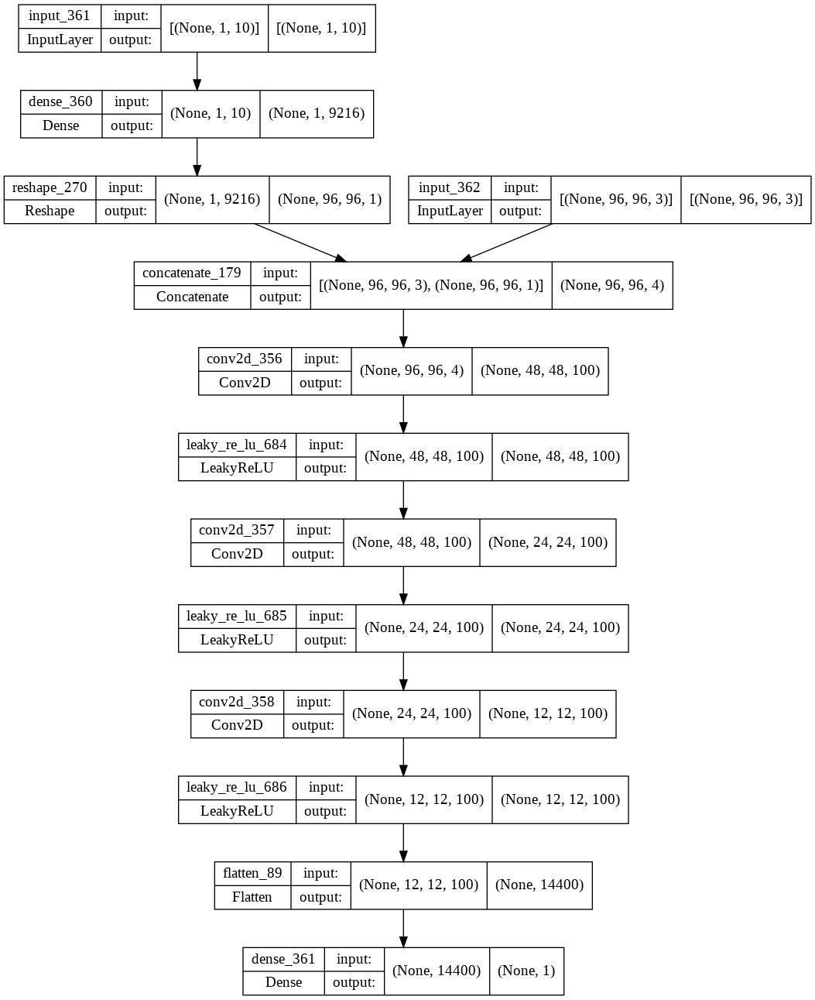

In [ ]:
def define_discriminator():
  #WRITE YOUR CODE HERE

  init = RandomNormal(mean=0.0, stddev=0.02)

  IMAGE_SHAPE_label = (IMAGE_SHAPE[0],IMAGE_SHAPE[1],1)
  
  input_label = Input(shape = (1,10))

  label_layers = Dense(9216)(input_label)

  label_layers = Reshape(IMAGE_SHAPE_label)(label_layers)

  input_image = Input (shape = IMAGE_SHAPE)

  merge = Concatenate()([input_image, label_layers])

  discrimator_layers = Conv2D(100, (5,5), strides=(2,2), padding='same',kernel_initializer=init,use_bias=False)(merge)

  discrimator_layers = LeakyReLU(alpha=0.2)(discrimator_layers)

  discrimator_layers = Conv2D(100, (3,3), strides=(2,2), padding='same',kernel_initializer=init,use_bias=False)(discrimator_layers)

  discrimator_layers = LeakyReLU(alpha=0.2)(discrimator_layers)

  discrimator_layers = Conv2D(100, (3,3), strides=(2,2), padding='same',kernel_initializer=init,use_bias=False)(discrimator_layers)

  discrimator_layers = LeakyReLU(alpha=0.2)(discrimator_layers)

  discrimator_layers = Flatten()(discrimator_layers)

  output_layer = Dense(1,activation = 'sigmoid')(discrimator_layers)

  model = Model([input_image, input_label], output_layer)
 
  return model

model = define_discriminator()

model.summary()

tf.keras.utils.plot_model(model, show_shapes=True, show_layer_names=True)

### Step 3 | Implementing the Generator Network
Now, we will implement the generator of the CGAN.

**Some important points:**
- All intermediate Convolutional/ Conv2DTranspose layers will have relu/ leakyrelu activation except the last one, which will have tanh.
- To improve the performance you can use kernel_initializer, Batchnormalization layer which suits you the best

Implement the generator in the cell below

Model: "model_184"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_364 (InputLayer)         [(None, 100)]        0           []                               
                                                                                                  
 input_363 (InputLayer)         [(None, 1, 10)]      0           []                               
                                                                                                  
 dense_363 (Dense)              (None, 14400)        1454400     ['input_364[0][0]']              
                                                                                                  
 dense_362 (Dense)              (None, 1, 144)       1584        ['input_363[0][0]']              
                                                                                          

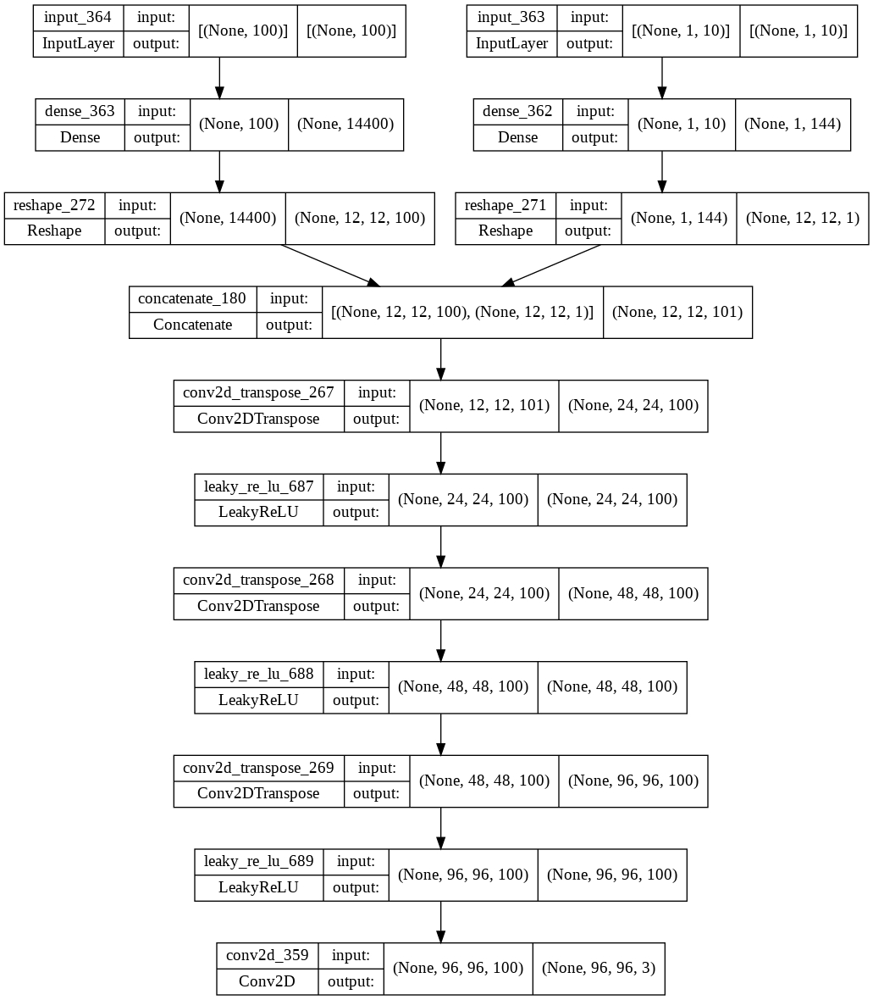

In [ ]:
def define_generator():
  #WRITE YOUR CODE HERE

  init = RandomNormal(mean=0.0, stddev=0.02)
  
  input_label = Input (shape = (1,10))

  input_latent_dim = Input (shape = (NOISE_DIM,))

  label_layers = Dense(144)(input_label)

  label_layers = Reshape ((12,12,1))(label_layers)

  latent_dim_layers = Dense(14400)(input_latent_dim)

  latent_dim_layers = Reshape((12,12,100))(latent_dim_layers)

  merge = Concatenate()([latent_dim_layers,label_layers])

  generator_layers = Conv2DTranspose(100, (3,3), strides=(2,2), padding='same',kernel_initializer=init,use_bias = False)(merge)

  generator_layers = LeakyReLU(alpha=0.2)(generator_layers)

  generator_layers = Conv2DTranspose(100, (3,3), strides=(2,2), padding='same',kernel_initializer=init,use_bias = False)(generator_layers)

  generator_layers = LeakyReLU(alpha=0.2)(generator_layers)

  generator_layers = Conv2DTranspose(100, (3,3), strides=(2,2), padding='same',kernel_initializer=init,use_bias = False)(generator_layers)

  generator_layers = LeakyReLU(alpha=0.2)(generator_layers)

  output_layer = Conv2D(CHANNELS, (3,3), strides=(1,1), padding='same',activation='tanh')(generator_layers)

  model = Model([input_latent_dim,input_label],output_layer)

  return model

model = define_generator()

model.summary()

tf.keras.utils.plot_model(model, show_shapes=True, show_layer_names=True)

### Step 4 | CGAN Training
Next, you will implement the training loop for the CGAN. The pseudo-code is given below.

**Algorithm:**    
1. Draw m training examples {x<sup>(1)</sup>,...,x<sup>(m)</sup>} from the data distribution p<sub>data</sub>.
2. Draw m noise samples {z<sup>(1)</sup>,...,z<sup>(m)</sup>} from the noise distribution p<sub>z</sub>.    
3. Generate fake images from the noise: G(z<sup>(i)</sup>) for i in {1,....,m}.    
4. Train discriminator (D) on real/fake data conditioned on their respective one-hot labels and then update the parameters.
5. Draw m new noise samples {z<sup>(1)</sup>,...,z<sup>(m)</sup>} from the noise distribution p<sub>z</sub>.    
6. Generate fake images from the noise: G(z<sup>(i)</sup>) for i in {1,....,m}.    
7. Freeze the discriminator.
8. Compute generator's loss then update the parameters.
9. Unfreeze the discriminator.

Before we move to writing the training loop, we will need to create a "combined" model that will attach the discriminator over the generator. This model will be used to train the generator as the discriminator will act as an adversary for the generator and force it to generate realistic images.

In this function below you need to create a model that:
- Takes noise z as input
- Gets a fake image generated from the generator using this noise z
- "Freezes" the discriminator (Setting all layers of the discriminator as untrainable)
- Outputs the output of the discriminator based on the input z.
Remember to compile the model before returning it.

In [ ]:
def define_gan(g_model, d_model):
  #WRITE YOUR CODE HERE
  d_model.trainable = False
  
  g_model_input_noise,g_model_input_label = g_model.input

  g_model_output = g_model.output

  d_model_output = d_model([g_model_output,g_model_input_label])

  model = Model([g_model_input_noise,g_model_input_label],d_model_output)

  return model

#### Scale Images to the Range [-1,1]
We already know that normalizing images improves training for any model. We will scale our images in the range [-1,1] since we are using a tanh activation in our generator. This will make the fake generated images and real images in the same range and will enable our discriminator to learn better.    
Implement the following function to normalize a numpy array containing images. 

**Note:** Fill it, If you haven't done that already. See if it helps in the training or not and add your comment below.

In [ ]:
'''Add your Comment'''

'Add your Comment'

In [ ]:
def normalize(images):
    # WRITE YOUR CODE HERE
    normalized_images = (images - 127.5) / 127.5
    # END HERE
    return normalized_images
X_train = normalize(X_train)

#### Use Label Smoothing
Normally, we use hard labels 1s and 0s to train our GANs. Researchers have suggested to smooth labels and use "soft" labels . This is said to have a "regularizing" effect on the training.

#### Real Label Smoothing
For Real labels, i.e. 1s, we will smooth the labels uniformly between [0.7,1.2]. Use np.random.random for this.

In [ ]:
def smooth_real_labels(y):
    # WRITE YOUR CODE HERE
    temp_random_numbers = np.random.random(len(y))

    y = (((temp_random_numbers - 0) * 0.5) / 1) + 0.7
    # END HERE
    return y

#### Fake Label Smoothing

In [ ]:
def smooth_fake_labels(y):
    # WRITE YOUR CODE HERE
    temp_random_numbers = np.random.random(len(y))

    y = (((temp_random_numbers - 0) * 0.3) / 1) + 0
    # END HERE
    return y

Write your training loop in the cell bellow. Some important points to keep in mind:
- You need to compile the discriminator after creating an instance using build_discriminator()
- To train your models, we won't make use of <code>fit</code> instead we will use <code>train_on_batch</code> to train our model over batches. This method will return your model's loss over a particular batch, which you will use to output and store your history of losses.
- Additionally, we will be generating samples after some epochs and storing the result on disk. You can modify according to your need.

In [ ]:
# You can modify accordingly
BASE_DIR = '/drive/MyDrive/gan_model'

def save_samples(generated_images,step):
    sample_image = create_image_grid(generated_images)
    img = tf.keras.utils.array_to_img(sample_image)
    img.save(os.path.join(BASE_DIR,'generated_image' + str(step) + '.png'))

#### Training the GAN


In [ ]:
# Setup Models here
def generate_real_samples(index):
  y = smooth_real_labels(np.ones((BATCH_SIZE,1)))

  labels = y_train[index:index+BATCH_SIZE].reshape(BATCH_SIZE,1,10)

  samples = X_train[index:index+BATCH_SIZE]

  return samples,labels,y  

def generate_fake_samples():
  latent_matrix = sample_noise()

  labels = tf.one_hot(np.random.randint(0, 10, BATCH_SIZE),10).numpy().reshape((BATCH_SIZE,1,10))

  samples = g_model.predict([latent_matrix,labels])

  y = smooth_fake_labels(np.zeros((BATCH_SIZE,1)))

  return samples,labels,y

d_model = define_discriminator()

opt = Adam(learning_rate=0.0002, beta_1=0.5)
 
d_model.compile(loss='binary_crossentropy', optimizer=opt)

# d_model.load_weights('/drive/MyDrive/gan_model/discriminator.h5')

g_model = define_generator()

# g_model.load_weights('/drive/MyDrive/gan_model/generator.h5')

gan_model = define_gan(g_model,d_model)

opt = Adam(learning_rate=0.0002, beta_1=0.5)

gan_model.compile(loss='binary_crossentropy', optimizer=opt)


In [ ]:
def training_loop(intervals=200):
    total_size = 13000
    indices = np.arange(0,total_size ,BATCH_SIZE)
    all_disc_loss = []
    all_gen_loss = []
    if total_size % BATCH_SIZE:
        indices = indices[:-1]
    for e in range(EPOCHS):
        progress_bar = Progbar(target=len(indices))
        np.random.shuffle(indices)
        epoch_gen_loss = []
        epoch_disc_loss = []
        for i,index in enumerate(indices):
            # Write your code here

            fake_samples,fake_labels,fake_y = generate_fake_samples()

            d_loss_fake = d_model.train_on_batch([fake_samples,fake_labels],fake_y)

            real_samples,real_labels,real_y = generate_real_samples(index)

            d_loss_real = d_model.train_on_batch([real_samples,real_labels],real_y)

            if not (e % intervals):
                save_samples(fake_samples,e)     
            
            disc_loss = (d_loss_real + d_loss_fake)/2
            epoch_disc_loss.append(disc_loss)
            
            # Before training your generator using the combined model, freeze all layers of the discriminator first.
            # Unfreeze after your call to train_on_batch
            d_model.trainable = False

            latent_points = sample_noise()

            fake_labels = tf.one_hot(np.random.randint(0, 10, BATCH_SIZE),10).numpy().reshape((BATCH_SIZE,1,10))

            gan_y = smooth_real_labels(np.ones((BATCH_SIZE,1)))

            gan_loss = gan_model.train_on_batch([latent_points,fake_labels],gan_y)

            gen_loss = gan_loss
            epoch_gen_loss.append(gen_loss)
            progress_bar.update(i+1)

            d_model.trainable = True
          
        if not (e%intervals):
            # Save weights here in case your runtime crashed during training
            d_model.save_weights(os.path.join(BASE_DIR,'discriminator'+'.h5'),True)
            g_model.save_weights(os.path.join(BASE_DIR,'generator'+'.h5'),True)
            
        avg_epoch_disc_loss = np.array(epoch_disc_loss).mean()
        avg_epoch_gen_loss = np.array(epoch_gen_loss).mean()
        all_disc_loss.append(avg_epoch_disc_loss)
        all_gen_loss.append(avg_epoch_gen_loss)

        print("Epoch: %d | Discriminator Loss: %f | Generator Loss: %f" % (e+1,avg_epoch_disc_loss,avg_epoch_gen_loss))
    return all_disc_loss,all_gen_loss

#### Step 5 | Generating Samples and Analysis

- Generate random noise samples and their corresponding fake images. For you convience, you can find some samples here [Real Samples](https://drive.google.com/file/d/1bNiPFu4StxBvdhqslM5d7ad3-mycwrMu/view?usp=sharing)
[Fake Samples](https://drive.google.com/file/d/12fIGZ_6NAC58KEgQuQfeOYVOFw45AjdD/view?usp=sharing)
These are just fake samples, you can generate better images. 

In [ ]:
def plot_loss(gen_loss,disc_loss):
    plt.plot(gen_loss)
    plt.plot(disc_loss)
    plt.title('GAN Loss')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(['Generator', 'Discriminator'], loc='upper left')
    plt.show()

In [ ]:
# WRITE YOU CODE HERE TO PLOT HISTORY
all_disc_loss,all_gen_loss = training_loop(10)

43/43 [==============================] - 51s 1s/step
Epoch: 1 | Discriminator Loss: 0.509312 | Generator Loss: 0.698642
43/43 [==============================] - 26s 614ms/step
Epoch: 2 | Discriminator Loss: 0.398684 | Generator Loss: 1.465310
43/43 [==============================] - 26s 614ms/step
Epoch: 3 | Discriminator Loss: 0.460929 | Generator Loss: 1.590933
43/43 [==============================] - 26s 616ms/step
Epoch: 4 | Discriminator Loss: 0.503923 | Generator Loss: 1.562719
43/43 [==============================] - 27s 616ms/step
Epoch: 5 | Discriminator Loss: 0.522433 | Generator Loss: 1.392329
43/43 [==============================] - 26s 615ms/step
Epoch: 6 | Discriminator Loss: 0.501562 | Generator Loss: 1.744837
43/43 [==============================] - 26s 614ms/step
Epoch: 7 | Discriminator Loss: 0.470970 | Generator Loss: 1.504065
43/43 [==============================] - 26s 615ms/step
Epoch: 8 | Discriminator Loss: 0.488585 | Generator Loss: 1.598833
43/43 [============

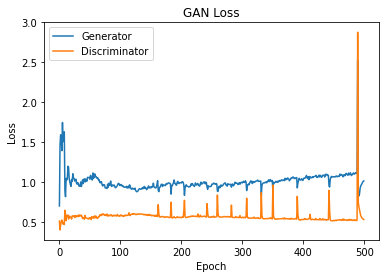

In [ ]:
plot_loss(all_gen_loss,all_disc_loss)

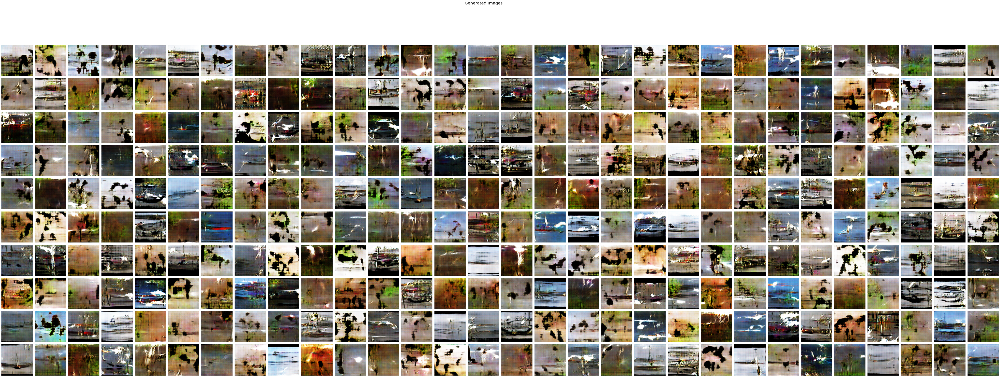

In [ ]:
generated_imgs,_,__ = generate_fake_samples()

generated_imgs = (generated_imgs+1)/2.0

display_image_grid(generated_imgs, 10, 30, "Generated Images")

## Task 1| Part (b) - [Grads Only/ 10% Bonus marks for Undergradudates ]

Use Mean squared Error Loss function for CGANs and differentiate between generated images.
Add your answer which Loss function (MSE, BCE) is better for stl10 classification and why.





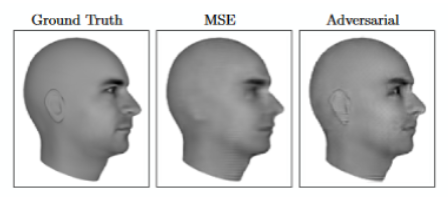

In [ ]:
# WRITE YOUR CODE HERE
'''
Modify you networks
'''

def define_discriminator():
  #WRITE YOUR CODE HERE

  init = RandomNormal(mean=0.0, stddev=0.02)

  IMAGE_SHAPE_label = (IMAGE_SHAPE[0],IMAGE_SHAPE[1],1)
  
  input_label = Input(shape = (1,10))

  label_layers = Dense(9216)(input_label)

  label_layers = Reshape(IMAGE_SHAPE_label)(label_layers)

  input_image = Input (shape = IMAGE_SHAPE)

  merge = Concatenate()([input_image, label_layers])

  discrimator_layers = Conv2D(100, (5,5), strides=(2,2), padding='same',kernel_initializer=init,use_bias=False)(merge)

  discrimator_layers = LeakyReLU(alpha=0.2)(discrimator_layers)

  discrimator_layers = Conv2D(100, (3,3), strides=(2,2), padding='same',kernel_initializer=init,use_bias=False)(discrimator_layers)

  discrimator_layers = LeakyReLU(alpha=0.2)(discrimator_layers)

  discrimator_layers = Conv2D(100, (3,3), strides=(2,2), padding='same',kernel_initializer=init,use_bias=False)(discrimator_layers)

  discrimator_layers = LeakyReLU(alpha=0.2)(discrimator_layers)

  discrimator_layers = Flatten()(discrimator_layers)

  output_layer = Dense(1)(discrimator_layers)

  model = Model([input_image, input_label], output_layer)
 
  return model


In [ ]:
def define_generator():
  #WRITE YOUR CODE HERE

  init = RandomNormal(mean=0.0, stddev=0.02)
  
  input_label = Input (shape = (1,10))

  input_latent_dim = Input (shape = (NOISE_DIM,))

  label_layers = Dense(144)(input_label)

  label_layers = Reshape ((12,12,1))(label_layers)

  latent_dim_layers = Dense(14400)(input_latent_dim)

  latent_dim_layers = Reshape((12,12,100))(latent_dim_layers)

  merge = Concatenate()([latent_dim_layers,label_layers])

  generator_layers = Conv2DTranspose(100, (3,3), strides=(2,2), padding='same',kernel_initializer=init,use_bias = False)(merge)

  generator_layers = LeakyReLU(alpha=0.2)(generator_layers)

  generator_layers = Conv2DTranspose(100, (3,3), strides=(2,2), padding='same',kernel_initializer=init,use_bias = False)(generator_layers)

  generator_layers = LeakyReLU(alpha=0.2)(generator_layers)

  generator_layers = Conv2DTranspose(100, (3,3), strides=(2,2), padding='same',kernel_initializer=init,use_bias = False)(generator_layers)

  generator_layers = LeakyReLU(alpha=0.2)(generator_layers)

  output_layer = Conv2D(CHANNELS, (3,3), strides=(1,1), padding='same',activation='tanh')(generator_layers)

  model = Model([input_latent_dim,input_label],output_layer)

  return model

In [ ]:
def define_gan(g_model, d_model):
  #WRITE YOUR CODE HERE
  d_model.trainable = False
  
  g_model_input_noise,g_model_input_label = g_model.input

  g_model_output = g_model.output

  d_model_output = d_model([g_model_output,g_model_input_label])

  model = Model([g_model_input_noise,g_model_input_label],d_model_output)

  return model

In [ ]:
X_train_and_labels , X_test_and_labels = load_data()

X_train_and_labels = list(tfds.as_numpy(X_train_and_labels))

X_test_and_labels = list(tfds.as_numpy(X_test_and_labels))

X_train = np.array([X_train_and_labels[i][0].astype('float32') for i in range(5000)])

y_train_labels = np.array([X_train_and_labels[i][1] for i in range(5000)])

X_test = np.array([X_test_and_labels[i][0].astype('float32') for i in range(8000)])

y_test_labels = np.array([X_test_and_labels[i][1] for i in range(8000)])

In [ ]:
y_train = tf.one_hot(y_train_labels,10).numpy()

y_test = tf.one_hot(y_test_labels,10).numpy()

In [ ]:
X_train = np.concatenate((X_train,X_test),axis = 0)

y_train = np.concatenate((y_train,y_test),axis = 0)

In [ ]:
def normalize(images):
    # WRITE YOUR CODE HERE
    normalized_images = (images - 127.5) / 127.5
    # END HERE
    return normalized_images
X_train = normalize(X_train)

def smooth_real_labels(y):
    # WRITE YOUR CODE HERE
    temp_random_numbers = np.random.random(len(y))

    y = (((temp_random_numbers - 0) * 0.5) / 1) + 0.7
    # END HERE
    return y

def smooth_fake_labels(y):
    # WRITE YOUR CODE HERE
    temp_random_numbers = np.random.random(len(y))

    y = (((temp_random_numbers - 0) * 0.3) / 1) + 0
    # END HERE
    return y

# You can modify accordingly
BASE_DIR = '/drive/MyDrive/gan_model'

def save_samples(generated_images,step):
    sample_image = create_image_grid(generated_images)
    img = tf.keras.utils.array_to_img(sample_image)
    img.save(os.path.join(BASE_DIR,'generated_image' + str(step) + '.png'))

def plot_loss(gen_loss,disc_loss):
    plt.plot(gen_loss)
    plt.plot(disc_loss)
    plt.title('GAN Loss')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(['Generator', 'Discriminator'], loc='upper left')
    plt.show()

In [ ]:
def generate_real_samples(index):
  y = smooth_real_labels(np.ones((BATCH_SIZE,1)))

  labels = y_train[index:index+BATCH_SIZE].reshape(BATCH_SIZE,1,10)

  samples = X_train[index:index+BATCH_SIZE]

  return samples,labels,y  

def generate_fake_samples():
  latent_matrix = sample_noise()

  labels = tf.one_hot(np.random.randint(0, 10, BATCH_SIZE),10).numpy().reshape((BATCH_SIZE,1,10))

  samples = g_model.predict([latent_matrix,labels])

  y = smooth_fake_labels(np.zeros((BATCH_SIZE,1)))

  return samples,labels,y

d_model = define_discriminator()

opt = Adam(learning_rate=0.0002, beta_1=0.5)
 
d_model.compile(loss='mse', optimizer=opt)

# d_model.load_weights('/drive/MyDrive/gan_model/discriminator.h5')

g_model = define_generator()

# g_model.load_weights('/drive/MyDrive/gan_model/generator.h5')

gan_model = define_gan(g_model,d_model)

opt = Adam(learning_rate=0.0002, beta_1=0.5)

gan_model.compile(loss='mse', optimizer=opt)

In [ ]:
all_disc_loss,all_gen_loss = training_loop(10)

43/43 [==============================] - 50s 1s/step
Epoch: 1 | Discriminator Loss: 0.075765 | Generator Loss: 0.710327
43/43 [==============================] - 27s 616ms/step
Epoch: 2 | Discriminator Loss: 0.106043 | Generator Loss: 0.549240
43/43 [==============================] - 26s 615ms/step
Epoch: 3 | Discriminator Loss: 0.120847 | Generator Loss: 0.557006
43/43 [==============================] - 26s 615ms/step
Epoch: 4 | Discriminator Loss: 0.081950 | Generator Loss: 0.591244
43/43 [==============================] - 26s 616ms/step
Epoch: 5 | Discriminator Loss: 0.080566 | Generator Loss: 0.634609
43/43 [==============================] - 26s 614ms/step
Epoch: 6 | Discriminator Loss: 0.060171 | Generator Loss: 0.639859
43/43 [==============================] - 26s 614ms/step
Epoch: 7 | Discriminator Loss: 0.055619 | Generator Loss: 0.557375
43/43 [==============================] - 26s 614ms/step
Epoch: 8 | Discriminator Loss: 0.066424 | Generator Loss: 0.548072
43/43 [============

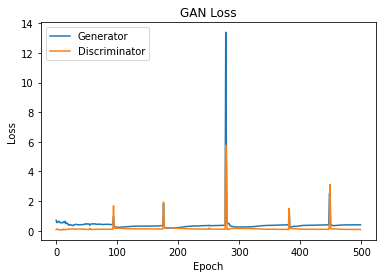

In [ ]:
plot_loss(all_gen_loss,all_disc_loss)

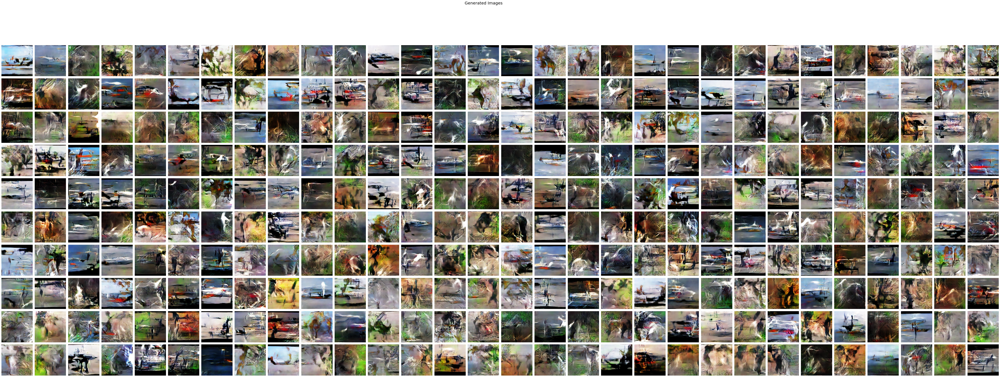

In [ ]:
generated_imgs,_,__ = generate_fake_samples()

generated_imgs = (generated_imgs+1)/2.0

display_image_grid(generated_imgs, 10, 30, "Generated Images")

## Task 2 | Interpolation

We'll use the same dataset as used for assignment 4. Model Weight is provided

In [ ]:
from google.colab import drive
drive.mount('/drive')

Drive already mounted at /drive; to attempt to forcibly remount, call drive.mount("/drive", force_remount=True).


In [ ]:
# replace this your google drive path of the zip file of dataset provided with this homework
!unzip -o -q "/drive/MyDrive/ffhq-dataset.zip" -d "/content/data/"

In [ ]:
# data folder path in colab runtime enviroment
DATA_FOLDER = '/content/'

# fetching all the filenmaes to read them later in generator
filenames = np.array(glob(os.path.join(DATA_FOLDER, '*/*.png')))

# total images in directory
NUM_IMAGES = len(filenames)
print("Total number of images : " + str(NUM_IMAGES))

Total number of images : 70000


In [ ]:
INPUT_DIM = (128,128,3) 
BATCH_SIZE = 512        
Z_DIM = 100            

DATA_FOLDER = '/content/data'

data_flow = ImageDataGenerator(rescale=1./255).flow_from_directory(DATA_FOLDER, target_size = INPUT_DIM[:2], 
                                                                   batch_size = BATCH_SIZE, shuffle = True, 
                                                                   class_mode = 'input', subset = 'training')

Found 70000 images belonging to 2 classes.


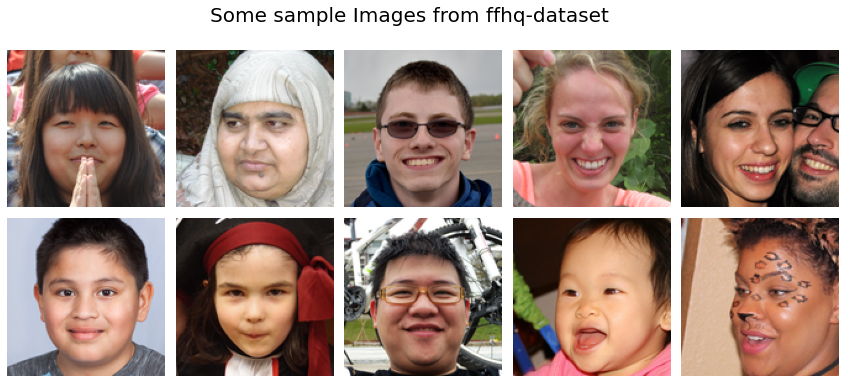

In [ ]:
# a batch of 512 images returned by data generator
sample_images = next(data_flow)[0] 

# only taking 10 of those to display
sample_images = sample_images[:10]

# displaying the images
display_image_grid(sample_images, 2, 5, "Some sample Images from ffhq-dataset")

*  Model weights are provided to you, use that model and interpolate 5 images.
*  If you want to train the model from scratch it's up to you.



In [ ]:
def define_generator():
	model = Sequential()
	n_nodes = 128 * 4 * 4
	model.add(Dense(n_nodes, input_dim=100))
	model.add(LeakyReLU(alpha=0.2))
	model.add(Reshape((4, 4, 128)))
	model.add(Conv2DTranspose(128, (4,4), strides=(2,2), padding='same'))
	model.add(LeakyReLU(alpha=0.2))
	model.add(Conv2DTranspose(128, (4,4), strides=(2,2), padding='same'))
	model.add(LeakyReLU(alpha=0.2))
	model.add(Conv2DTranspose(128, (4,4), strides=(2,2), padding='same'))
	model.add(LeakyReLU(alpha=0.2))
	model.add(Conv2DTranspose(128, (4,4), strides=(2,2), padding='same'))
	model.add(LeakyReLU(alpha=0.2))
 
	model.add(Conv2DTranspose(128, (4,4), strides=(2,2), padding='same'))
	model.add(LeakyReLU(alpha=0.2))
 
	model.add(Conv2D(3, (5,5), activation='tanh', padding='same'))
	return model

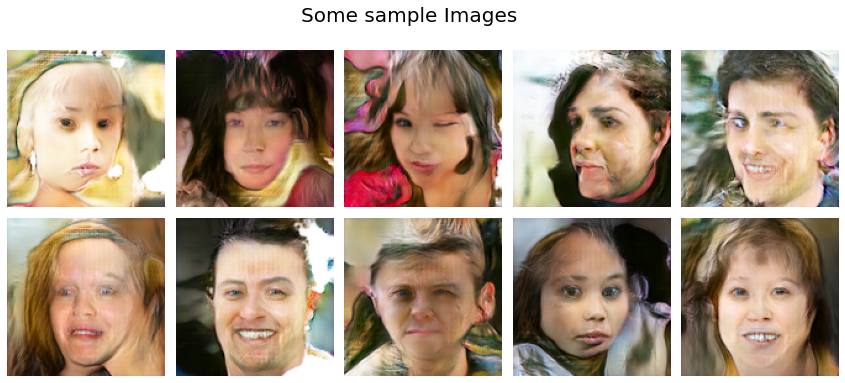

In [ ]:
# Some Fake Samples
generator = define_generator()

generator.load_weights('/content/generator.h5')

prediction_latent_points = sample_noise()

X = generator.predict(prediction_latent_points)
display_image_grid(X, 2, 5, "Some sample Images")

You can play around with the images for example:
	
1.  *Glasses on Woman - Neutral Woman + Neutral Man = Glasses on Man*
2.  *Smile on Woman - Neutral Woman + Neutral Man = smile on Man*

Create 10 different scenarios and display

In [ ]:
# WRITE YOUR CODE HERE
def interpolation():
  z = sample_noise()
  ratios = np.linspace(0,1,num=10)
  li = [(1.0 - x)*z[0]+x*z[1] for x in ratios]
  return np.asarray(li)

#### Display Results

In [ ]:
# WRITE YOUR CODE HERE
imgs = []
BATCH_SIZE = 2
samples = 10
for _ in range(samples):
  interpolated_X = interpolation()
  imgs.append(generator.predict(interpolated_X))
imgs = np.reshape(imgs,(samples*10,INPUT_DIM[0],INPUT_DIM[1],INPUT_DIM[2]))

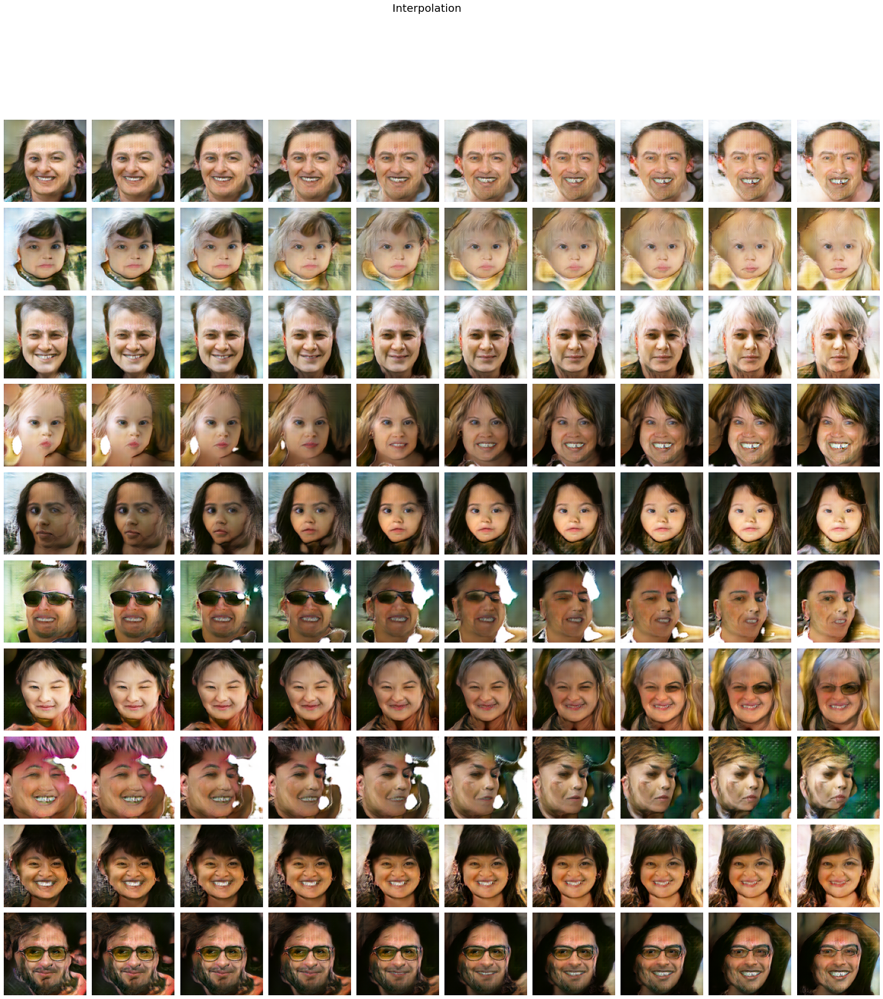

In [ ]:
display_image_grid(imgs,10,10, "Interpolation")